In [1]:
cd F:\PROJECTS\PROJECT_MONKEY SC-RNA SEQ\WORKPLACE\R\

F:\PROJECTS\PROJECT_MONKEY SC-RNA SEQ\WORKPLACE\R


G:\Miniconda3\envs\scvi-env\lib\site-packages\IPython\core\magics\osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [2]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import os
import sys
import scipy
import anndata


plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams["font.family"] = "Arial"

sc.set_figure_params(figsize=(4, 4))
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 600, vector_friendly = True, format = 'pdf')
palette = ['#fbbc04', '#199de5', '#cfe6d5']

In [3]:
def Barplot(which_var, adata, var='clusters', height=3, color = False):
    plotdata = pd.crosstab(adata.obs[var], adata.obs[which_var], normalize='index') * 100
    if 'category' in plotdata.index.dtype.name:
        plotdata.index.reorder_categories(adata.obs[var].cat.categories[::-1])

    if not color:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False)
    else:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False, color = color)
    ax1.set_title(which_var+' %')
    ax1.set_ylabel(var)
    horiz_offset = 1
    vert_offset = 1.
    ax1 = ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset))
#     ax1.figure.savefig(str(sc.settings.figdir)+'/barplot_'+var+'_proportions_'+which_var+'.pdf', bbox_inches='tight',
#    

In [4]:
# Load dataset we want to transfer label to
adata = sc.read("scvi_macaque_cell-type_final.h5ad")
print("adata dims: {}".format(adata.shape)) 

G:\Miniconda3\envs\scvi-env\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


adata dims: (36701, 15315)


In [5]:
adata.obs['cell_type'].value_counts()

Fb                       7912
Ms                       4173
CC_ISC_OSC               3203
Bs                       3095
TBC                      2875
Schwann.Cells            2800
Sp/Rt                    2379
IDC                      2105
Is                       1885
IBC_IPh_HeC              1581
Endo.Cells               1412
macrophages               888
TypeI_SGN                 871
DC_PC                     847
HC                        259
SMC                       136
Satellite.glial.cells     112
TypeII_SGN                 84
pericytes                  84
Name: cell_type, dtype: int64

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


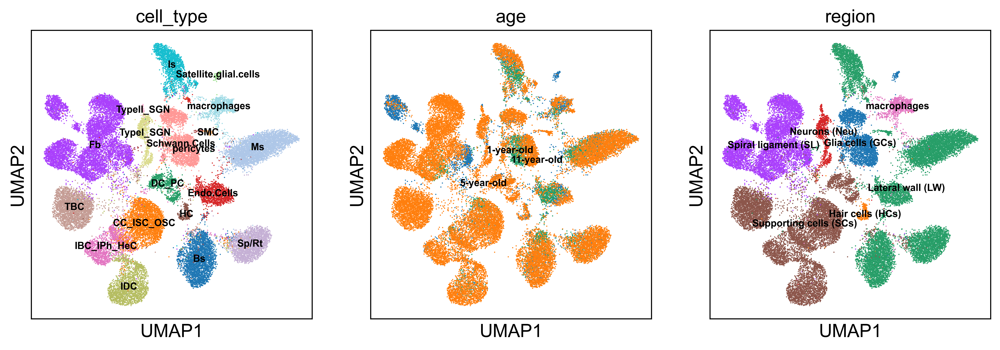

In [6]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=300,dpi_save=600)
sc.pl.umap(
    adata,
    color=['cell_type','age','region'], 
    legend_loc='on data',
    wspace=0.1, legend_fontsize=7.5,
    frameon=True
)#ncols = 1,

In [7]:
adata.obs['age'].value_counts()

5-year-old     27616
11-year-old     4634
1-year-old      4451
Name: age, dtype: int64

In [8]:
adata_1y= adata[adata.obs['age'].isin(['1-year-old']), :]
adata_1y

View of AnnData object with n_obs × n_vars = 4451 × 15315
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region'
    var: 'gene_ids', 'feature_types', 'Gene', 'genome-0', 'n_cells-0', 'm-0', 'v-0', 'n_obs-0', 'res-0', 'lp-0', 'lpa-0', 'qv-0', 'highly_variable-0', 'mt-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'Mt-0', 'MT-0', 'HB-0', 'Hb-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'genome-1', 'n_cells-1', 'm-1', 'v-1', 'n_obs-1', 'res-1', 'lp-1', 'lpa-1', 'qv-1', 'highly_variable-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'MT-1', 'Hb-1'

In [9]:
adata_5y= adata[adata.obs['age'].isin(['5-year-old']), :]
adata_5y

View of AnnData object with n_obs × n_vars = 27616 × 15315
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region'
    var: 'gene_ids', 'feature_types', 'Gene', 'genome-0', 'n_cells-0', 'm-0', 'v-0', 'n_obs-0', 'res-0', 'lp-0', 'lpa-0', 'qv-0', 'highly_variable-0', 'mt-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'Mt-0', 'MT-0', 'HB-0', 'Hb-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'genome-1', 'n_cells-1', 'm-1', 'v-1', 'n_obs-1', 'res-1', 'lp-1', 'lpa-1', 'qv-1', 'highly_variable-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'MT-1', 'Hb-1

In [10]:
adata_11y= adata[adata.obs['age'].isin(['11-year-old']), :]
adata_11y

View of AnnData object with n_obs × n_vars = 4634 × 15315
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region'
    var: 'gene_ids', 'feature_types', 'Gene', 'genome-0', 'n_cells-0', 'm-0', 'v-0', 'n_obs-0', 'res-0', 'lp-0', 'lpa-0', 'qv-0', 'highly_variable-0', 'mt-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'Mt-0', 'MT-0', 'HB-0', 'Hb-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'genome-1', 'n_cells-1', 'm-1', 'v-1', 'n_obs-1', 'res-1', 'lp-1', 'lpa-1', 'qv-1', 'highly_variable-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'MT-1', 'Hb-1'

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


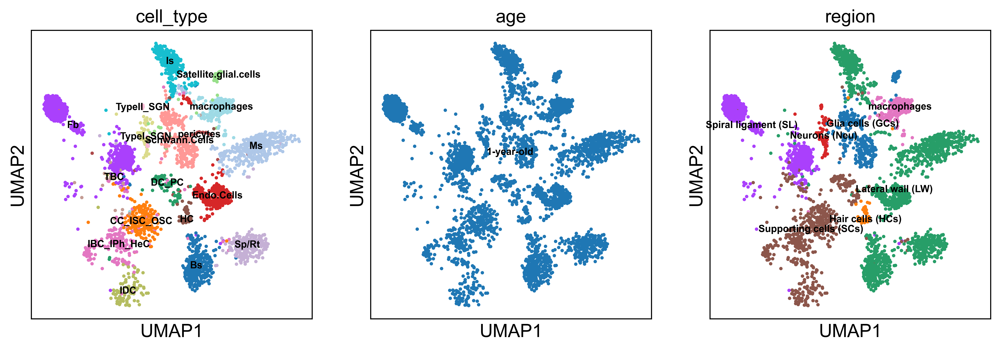

In [11]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=300,dpi_save=600)
sc.pl.umap(
    adata_1y,
    color=['cell_type','age','region'], 
    legend_loc='on data',
    wspace=0.1, legend_fontsize=7.5,
    frameon=True
)#ncols = 1,

In [13]:
# we add jean et al PNAS dataset as a comparative counterpart for this developmental expression pattern analysis
adata_mouse_pnas=sc.read("scRNA_P8P12P20.h5ad")

In [47]:
adata_mouse_pnas_P8 = adata_mouse_pnas[adata_mouse_pnas.obs['age']=='P8']
adata_mouse_pnas_P8
adata_mouse_pnas_P12 = adata_mouse_pnas[adata_mouse_pnas.obs['age']=='P12']
adata_mouse_pnas_P12
adata_mouse_pnas_P20 = adata_mouse_pnas[adata_mouse_pnas.obs['age']=='P20']
adata_mouse_pnas_P20

View of AnnData object with n_obs × n_vars = 39010 × 39970
    obs: 'cell_type', 'age', 'louvain'
    var: 'gene_symbol'

In [48]:
sc.pp.filter_genes(adata_mouse_pnas_P8,min_cells=1)
adata_mouse_pnas_P8.layers["counts"] = adata_mouse_pnas_P8.X.copy() 
adata_mouse_pnas_P8.X = adata_mouse_pnas_P8.layers["counts"].copy()
sc.pp.normalize_total(adata_mouse_pnas_P8)
sc.pp.log1p(adata_mouse_pnas_P8)
adata_mouse_pnas_P8.layers["logcounts"] = adata_mouse_pnas_P8.X.copy()
adata_mouse_pnas_P8.layers["scaled"]=sc.pp.scale(adata_mouse_pnas_P8.X,max_value=5,copy=True)
adata_mouse_pnas_P8

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\preprocessing\_simple.py:250: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


AnnData object with n_obs × n_vars = 26169 × 35250
    obs: 'cell_type', 'age', 'louvain'
    var: 'gene_symbol', 'n_cells'
    uns: 'log1p'
    layers: 'counts', 'logcounts', 'scaled'

In [49]:
sc.pp.filter_genes(adata_mouse_pnas_P12,min_cells=1)
adata_mouse_pnas_P12.layers["counts"] = adata_mouse_pnas_P12.X.copy() 
adata_mouse_pnas_P12.X = adata_mouse_pnas_P12.layers["counts"].copy()
sc.pp.normalize_total(adata_mouse_pnas_P12)
sc.pp.log1p(adata_mouse_pnas_P12)
adata_mouse_pnas_P12.layers["logcounts"] = adata_mouse_pnas_P12.X.copy()
adata_mouse_pnas_P12.layers["scaled"]=sc.pp.scale(adata_mouse_pnas_P12.X,max_value=5,copy=True)
adata_mouse_pnas_P12

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\preprocessing\_simple.py:250: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


AnnData object with n_obs × n_vars = 22827 × 35786
    obs: 'cell_type', 'age', 'louvain'
    var: 'gene_symbol', 'n_cells'
    uns: 'log1p'
    layers: 'counts', 'logcounts', 'scaled'

In [50]:
sc.pp.filter_genes(adata_mouse_pnas_P20,min_cells=1)
adata_mouse_pnas_P20.layers["counts"] = adata_mouse_pnas_P20.X.copy() 
adata_mouse_pnas_P20.X = adata_mouse_pnas_P20.layers["counts"].copy()
sc.pp.normalize_total(adata_mouse_pnas_P20)
sc.pp.log1p(adata_mouse_pnas_P20)
adata_mouse_pnas_P20.layers["logcounts"] = adata_mouse_pnas_P20.X.copy()
adata_mouse_pnas_P20.layers["scaled"]=sc.pp.scale(adata_mouse_pnas_P20.X,max_value=5,copy=True)
adata_mouse_pnas_P20

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\preprocessing\_simple.py:250: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


AnnData object with n_obs × n_vars = 39010 × 35983
    obs: 'cell_type', 'age', 'louvain'
    var: 'gene_symbol', 'n_cells'
    uns: 'log1p'
    layers: 'counts', 'logcounts', 'scaled'

In [18]:
sc.pp.filter_genes(adata_1y,min_cells=1)
adata_1y.layers["counts"] = adata_1y.X.copy() 
adata_1y.X = adata_1y.layers["counts"].copy()
sc.pp.normalize_total(adata_1y)
sc.pp.log1p(adata_1y)
adata_1y.layers["logcounts"] = adata_1y.X.copy()
adata_1y.layers["scaled"]=sc.pp.scale(adata_1y.X,max_value=5,copy=True)
adata_1y


G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\preprocessing\_simple.py:250: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


AnnData object with n_obs × n_vars = 4451 × 15038
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region'
    var: 'gene_ids', 'feature_types', 'Gene', 'genome-0', 'n_cells-0', 'm-0', 'v-0', 'n_obs-0', 'res-0', 'lp-0', 'lpa-0', 'qv-0', 'highly_variable-0', 'mt-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'Mt-0', 'MT-0', 'HB-0', 'Hb-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'genome-1', 'n_cells-1', 'm-1', 'v-1', 'n_obs-1', 'res-1', 'lp-1', 'lpa-1', 'qv-1', 'highly_variable-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'MT-1', 'Hb-1', 'means

In [19]:
sc.pp.filter_genes(adata_5y,min_cells=1)
adata_5y.layers["counts"] = adata_5y.X.copy() 
adata_5y.X = adata_5y.layers["counts"].copy()
sc.pp.normalize_total(adata_5y)
sc.pp.log1p(adata_5y)
adata_5y.layers["logcounts"] = adata_5y.X.copy()
adata_5y.layers["scaled"]=sc.pp.scale(adata_5y.X,max_value=5,copy=True)
adata_5y

AnnData object with n_obs × n_vars = 27616 × 15302
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region'
    var: 'gene_ids', 'feature_types', 'Gene', 'genome-0', 'n_cells-0', 'm-0', 'v-0', 'n_obs-0', 'res-0', 'lp-0', 'lpa-0', 'qv-0', 'highly_variable-0', 'mt-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'Mt-0', 'MT-0', 'HB-0', 'Hb-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'genome-1', 'n_cells-1', 'm-1', 'v-1', 'n_obs-1', 'res-1', 'lp-1', 'lpa-1', 'qv-1', 'highly_variable-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'MT-1', 'Hb-1', 'mean

In [20]:
sc.pp.filter_genes(adata_11y,min_cells=1)
adata_11y.layers["counts"] = adata_11y.X.copy() 
adata_11y.X = adata_11y.layers["counts"].copy()
sc.pp.normalize_total(adata_11y)
sc.pp.log1p(adata_11y)
adata_11y.layers["logcounts"] = adata_11y.X.copy()
adata_11y.layers["scaled"]=sc.pp.scale(adata_11y.X,max_value=5,copy=True)
adata_11y

AnnData object with n_obs × n_vars = 4634 × 14966
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region'
    var: 'gene_ids', 'feature_types', 'Gene', 'genome-0', 'n_cells-0', 'm-0', 'v-0', 'n_obs-0', 'res-0', 'lp-0', 'lpa-0', 'qv-0', 'highly_variable-0', 'mt-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'Mt-0', 'MT-0', 'HB-0', 'Hb-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'genome-1', 'n_cells-1', 'm-1', 'v-1', 'n_obs-1', 'res-1', 'lp-1', 'lpa-1', 'qv-1', 'highly_variable-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'MT-1', 'Hb-1', 'means

In [21]:
#genes related nonsyndromic SNHL in hair cells
markers_macaque = ['ATP2B2','CABP2','CDC14A','CDH23','CLRN2',
           'DIABLO','DMXL2','EPS8','EPS8L2','GRXCR1','GRXCR2','HOMER2','KCNQ4',
           'LOXHD1','MYO15A','MYO3A','MYO6','MYO7A','OSBPL2','OTOF','PCDH15','PDE1C','PDZD7','PLS1','POU4F3','PRPS1',
           'PTPRQ','RDX',
           'SIX1','SERPINB6','SLC17A8','SLC26A5','SYNE4','TBC1D24','TNC','USH1C',

          ]#'PJVK', 'RIPOR2', 'WHRN','CLRN2''ESPN','STRC',

In [41]:
#genes related nonsyndromic SNHL in hair cells
markers_mouse = ['Atp2b2','Cabp2','Cdc14a','Cdh23','Clrn2',
           'Diablo','Dmxl2','Eps8','Eps8l2','Grxcr1','Grxcr2','Homer2','Kcnq4',
           'Loxhd1','Myo15','Myo3a','Myo6','Myo7a','Osbpl2','Otof','Pcdh15','Pde1c','Pdzd7','Pls1','Pou4f3','Prps1',
           'Ptprd','Rdx',
           'Six1','Serpinb6a','Slc17a8','Slc26a5','Syne4','Tbc1d24','Tnc','Ush1c',

          ]#'PJVK', 'RIPOR2', 'WHRN','CLRN2''ESPN','STRC',

In [42]:
adata_mouse_pnas.obs['cell_type'].value_counts()

B cells                                  13414
Erythrocytes                             12858
Intermediate stria                        9236
Tympanic border cells                     7698
Neutrophils                               6360
SS1                                       4701
Osteocytes                                4323
Macrophages                               4223
Schwann cells                             3464
Monocytes                                 2567
Fibrocytes                                1935
Glial cells                               1655
T cells                                   1518
Pre-osteoblasts                           1287
Inner border-phalangeal/ Hensen cells      988
Claudius/Inner-Outer sulcus cells          921
Scala vestibuli border cells               875
NK cells                                   841
SS2                                        746
Root cells                                 734
Marginal stria                             722
Osteoblasts  

In [46]:
adata_mouse_pnas_P8.obs['cell_type'].value_counts()

OB                       4938
Immun                    3714
ECs                      2666
Schwann.Cells            2507
TBC                      2420
macrophages              1978
Fb                       1582
IC                       1329
IBC_IPh_HeC               645
Satellite.glial.cells     633
CC_ISC_OSC                394
Endo.Cells                332
Sp/Rt                     293
DC_PC                     251
Glial precursor cells     219
Svb                       194
Ms                        170
pericytes                  88
SMC                        76
RM                         64
IDC                        58
TypeII_SGN                 49
IHC                        46
Bs                         21
Name: cell_type, dtype: int64

In [51]:
cluster_annotation = {
    'B cells': 'Immun',
    'Erythrocytes': 'ECs',
    'Intermediate stria': 'Is',
    'Tympanic border cells': 'TBC',
    'Neutrophils': 'Immun',
    'SS1': 'OB',
    'Osteocytes': 'OB',
    'Macrophages': 'macrophages',
    'Schwann cells': 'Schwann.Cells',
    'Monocytes': 'Immun',
    'Fibrocytes': 'Fb',
    'Glial cells': 'Satellite.glial.cells',
    'T cells': 'Immun',
    'Pre-osteoblasts': 'OB',
    'Inner border-phalangeal/ Hensen cells': 'IBC_IPh_HeC',
    'Claudius/Inner-Outer sulcus cells': 'CC_ISC_OSC',
    'Scala vestibuli border cells': 'Svb',
    'NK cells': 'Immun',
    'SS2': 'OB',
    'Root cells': 'Sp/Rt',
    'Marginal stria': 'Ms',
    'Osteoblasts': 'OB',
    "Deiter's cells" : 'DC_PC',
    'Endothelial cells': 'Endo.Cells',
    'Glial precursor cells': 'Glial precursor cells',
    'Spindle cells': 'Sp/Rt',
    'Inner hair cells': 'IHC',
    'Pillar cells': 'DC_PC',
    'Reissner membrane': 'RM',
    'Mast cells': 'Immun',
    'Type I Neurons': 'TypeI_SGN',
    'Pericytes': 'pericytes',
    'Interdental cells': 'IDC',
    'Smooth muscle cells': 'SMC',
    'Basal stria': 'Bs',
    'Type I Neurons': 'TypeII_SGN'
}

adata_mouse_pnas_P8.obs['cell_type'] = adata_mouse_pnas_P8.obs['cell_type'].map(cluster_annotation).astype('category')
adata_mouse_pnas_P12.obs['cell_type'] = adata_mouse_pnas_P12.obs['cell_type'].map(cluster_annotation).astype('category')
adata_mouse_pnas_P20.obs['cell_type'] = adata_mouse_pnas_P20.obs['cell_type'].map(cluster_annotation).astype('category')

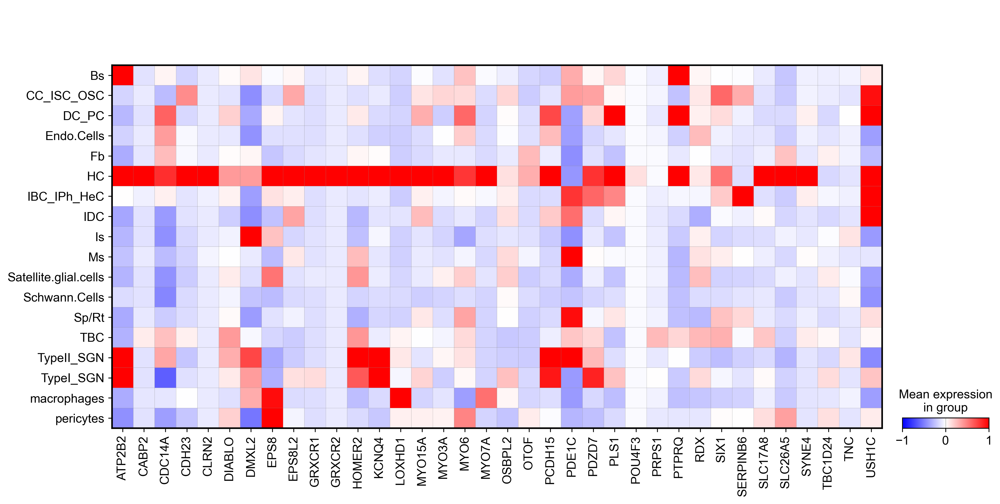

In [25]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_1y,groupby='cell_type')
gs = sc.pl.matrixplot(adata_1y, markers_macaque, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="nonsyndromic_HAIR_CELL_macaque_1year.pdf"
                     )

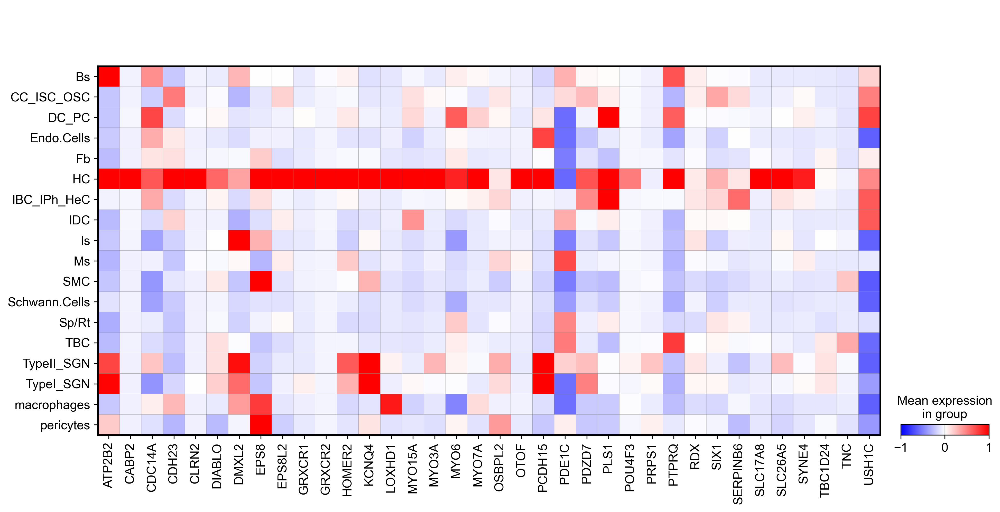

In [26]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
#sc.tl.dendrogram(adata_5y,groupby='cell_type')
gs = sc.pl.matrixplot(adata_5y, markers_macaque, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="nonsyndromic_HAIR_CELL_macaque_5year.pdf"
                     )

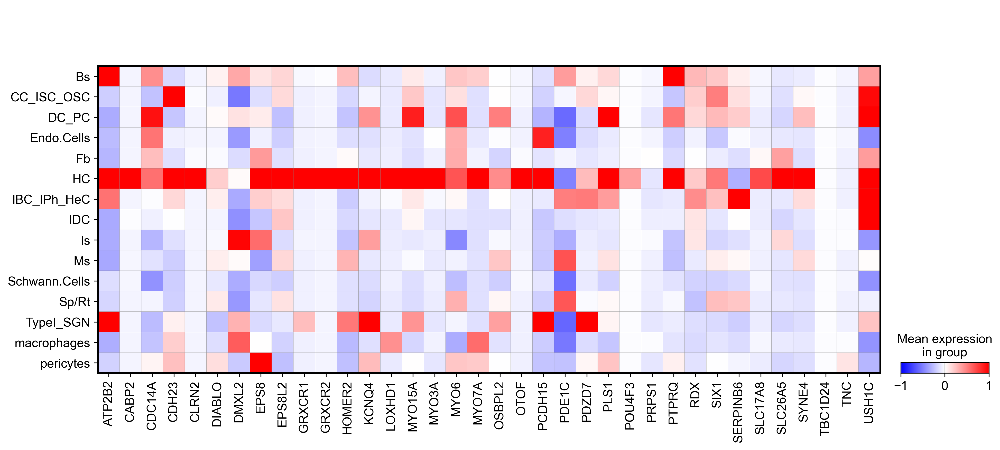

In [27]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_11y,groupby='cell_type')
gs = sc.pl.matrixplot(adata_11y, markers_macaque, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="nonsyndromic_HAIR_CELL_macaque_11year.pdf"
                     )

         Falling back to preprocessing with `sc.pp.pca` and default params.


G:\Miniconda3\envs\scvi-env\lib\site-packages\anndata\_core\anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


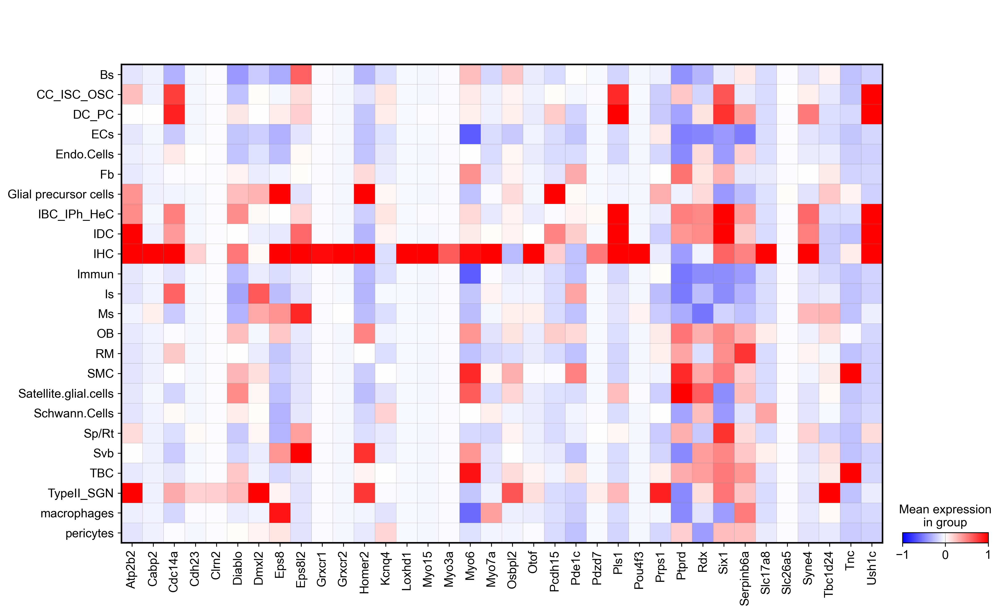

In [52]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P8,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P8, markers_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="nonsyndromic_HAIR_CELL_mouse_P8.pdf"
                     )

In [54]:
#genes related nonsyndromic SNHL in hair cells
markers_mouse_p12 = ['Atp2b2','Cabp2','Cdc14a','Cdh23','Clrn2',
           'Diablo','Dmxl2','Eps8','Eps8l2','Grxcr1','Grxcr2','Homer2','Kcnq4',
           'Loxhd1','Myo15','Myo3a','Myo6','Myo7a','Osbpl2','Otof','Pcdh15','Pde1c','Pdzd7','Pls1','Pou4f3','Prps1',
           'Ptprd','Rdx',
           'Six1','Serpinb6a','Slc17a8','Syne4','Tbc1d24','Tnc','Ush1c',

          ]#'PJVK', 'RIPOR2', 'WHRN','CLRN2''ESPN','STRC',

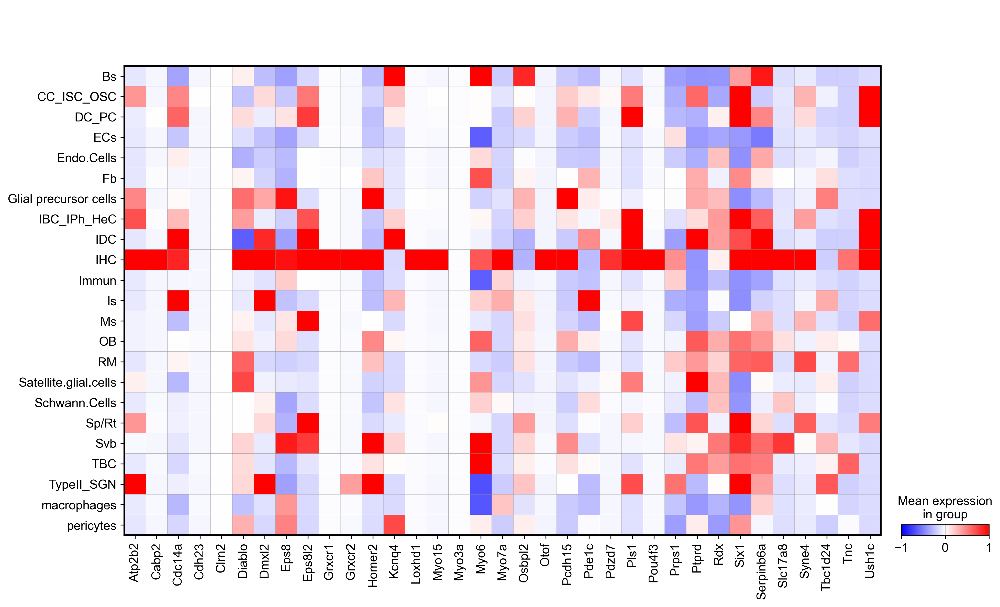

In [55]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P12,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P12, markers_mouse_p12, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="nonsyndromic_HAIR_CELL_mouse_P12.pdf"
                     )

         Falling back to preprocessing with `sc.pp.pca` and default params.


G:\Miniconda3\envs\scvi-env\lib\site-packages\anndata\_core\anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


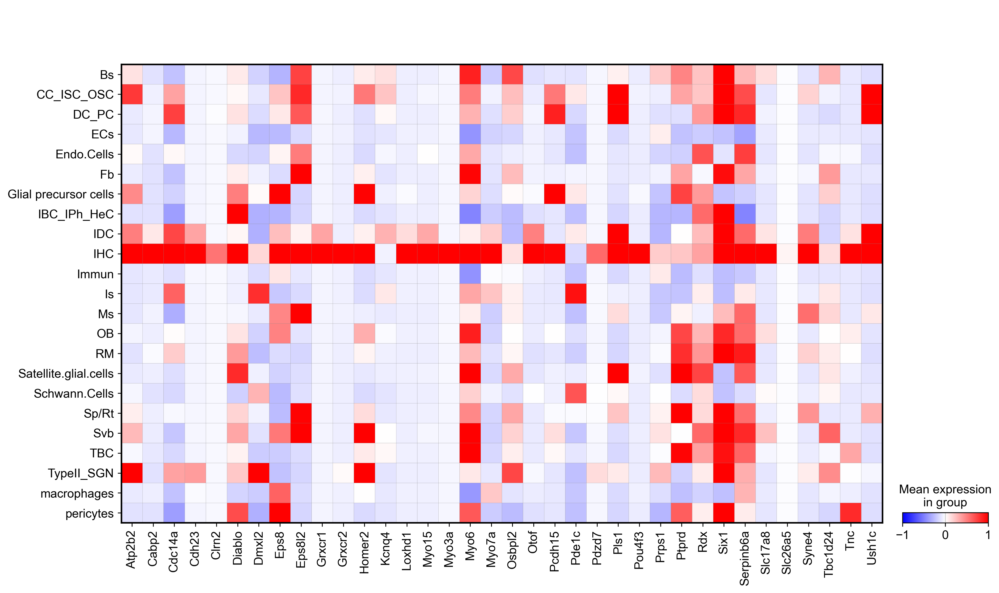

In [56]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P20,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P20, markers_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="nonsyndromic_HAIR_CELL_mouse_P20.pdf"
                     )

In [57]:
markers2_macaque = ['AIFM1','BDP1','CCDC50','CD164','CLDN14','COL11A1','COL11A2','COL4A6','DIAPH3','ESRP1','ESRRB','EYA4','GAB1',
           'GAS2','GJB2','GJB6','GPSM2','GRHL2','HGF','IFNLR1','ILDR1','KITLG','LMX1A','MAP1B','MARVELD2','MCM2','MET',
           'MPZL2','MYH14','MYH9','NARS2','OTOA','OTOG','OTOGL','P2RX2','PNPT1','PPIP5K2','REST','ROR1','S1PR2','SCD5','SLC12A2',
           'SLC26A4','SMPX','SPNS2','TECTA','TMC1','TMEM132E','TMIE','TMPRSS3','TRRAP','WBP2','WFS1'

          ]# 'TRPN','GSDME', 'TSPEAR''BSND'

In [64]:
markers2_mouse = ['Aifm1','Bdp1','Ccdc50','Cd164','Cldn14','Col11a1','Col11a2','Col4a6','Diaph3','Esrp1','Esrrb','Eya4','Gab1',
           'Gas2','Gjb2','Gjb6','Gpsm2','Grhl2','Hgf','Ifnlr1','Ildr1','Kitl','Lmx1a','Map1b','Marveld2','Mcm2','Met',
           'Mpzl2','Myh14','Myh9','Nars2','Otoa','Otog','Otogl','P2rx2','Pnpt1','Ppip5k2','Rest','Ror1','S1pr2','Slc12a2',
           'Slc26a4','Smpx','Spns2','Tecta','Tmc1','Tmem132e','Tmie','Tmprss3','Trrap','Wbp2','Wfs1'

          ]# 'TRPN','GSDME', 'TSPEAR''BSND'

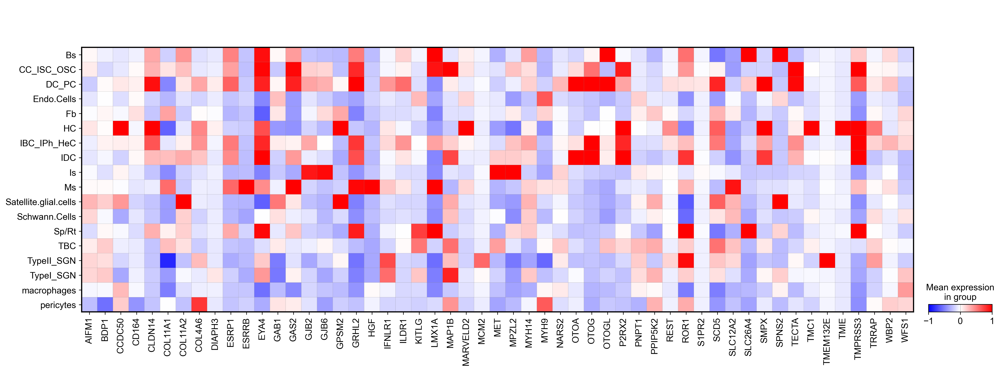

In [59]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_1y,groupby='cell_type')
gs = sc.pl.matrixplot(adata_1y, markers2_macaque, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="nonsyndromic_MULTIPLE_CELL_TYPES_macaque_1year.pdf"
                     )

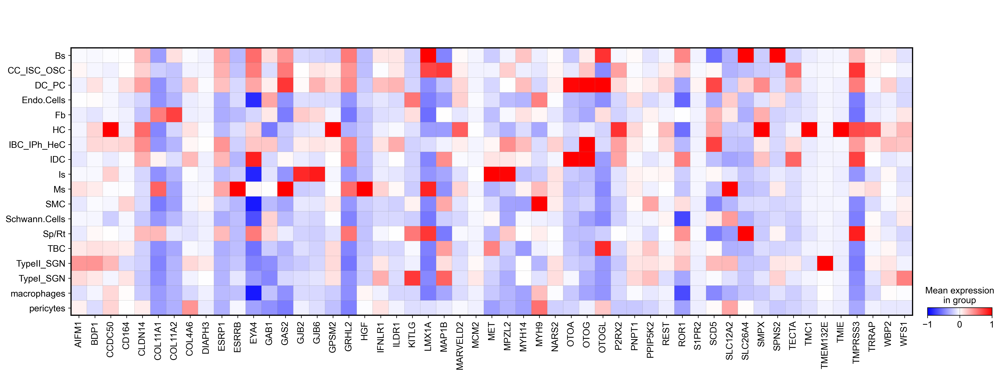

In [60]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_5y,groupby='cell_type')
gs = sc.pl.matrixplot(adata_5y, markers2_macaque, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="nonsyndromic_MULTIPLE_CELL_TYPES_macaque_5year.pdf"
                     )

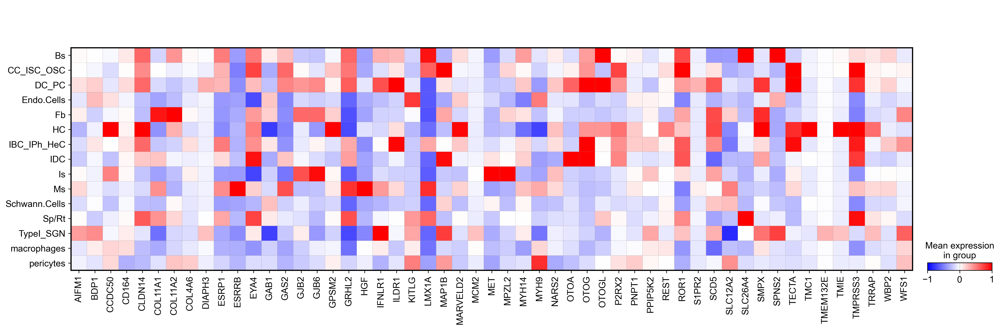

In [61]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_11y,groupby='cell_type')
gs = sc.pl.matrixplot(adata_11y, markers2_macaque, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="nonsyndromic_MULTIPLE_CELL_TYPES_macaque_11year.pdf"
                     )

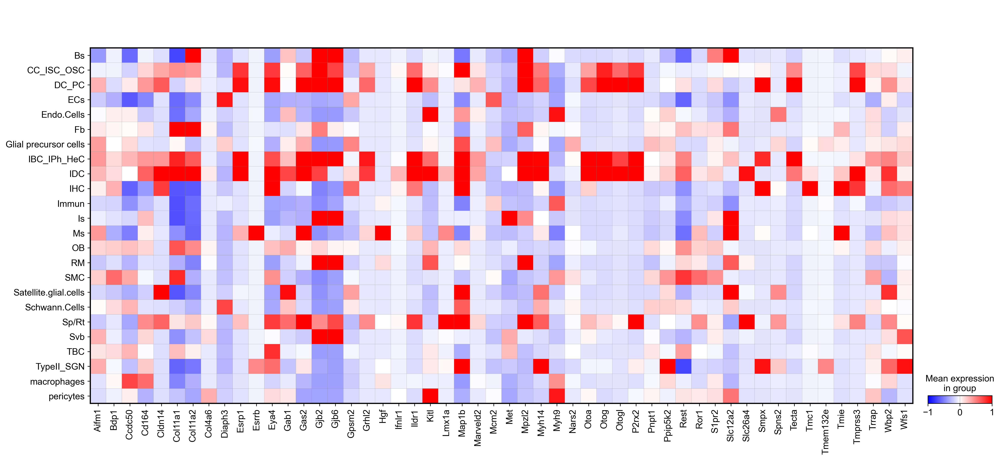

In [65]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P8,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P8, markers2_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="nonsyndromic_MULTIPLE_CELL_TYPES_mouse_P8.pdf"
                     )

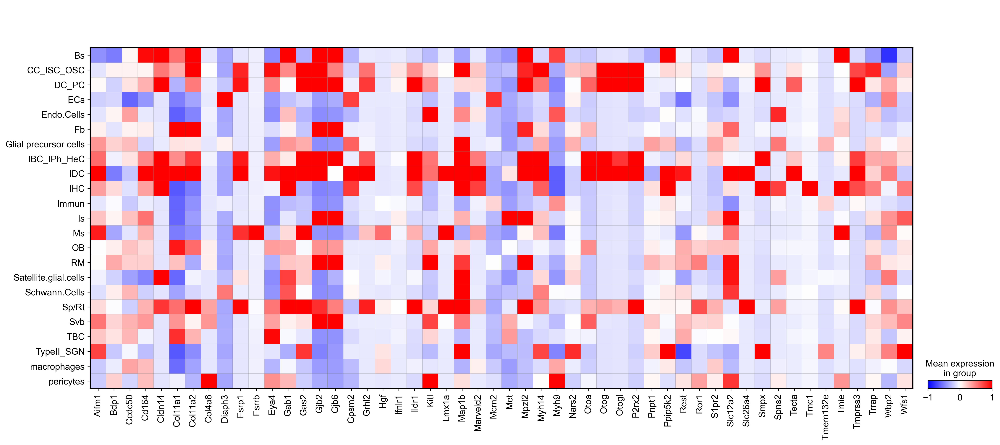

In [66]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P12,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P12, markers2_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="nonsyndromic_MULTIPLE_CELL_TYPES_mouse_P12.pdf"
                     )

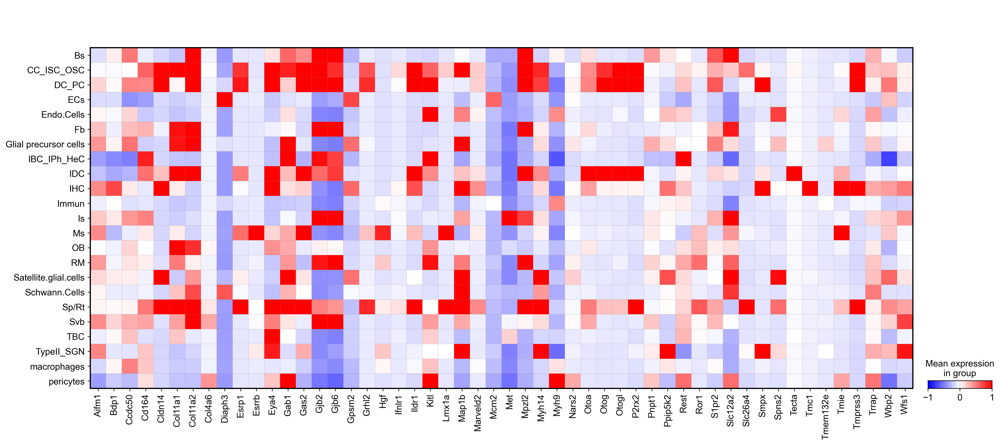

In [67]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P20,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P20, markers2_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="nonsyndromic_MULTIPLE_CELL_TYPES_mouse_P20.pdf"
                     )

In [69]:
#genes related nonsyndromic SNHL in SGN
markers3_macaque = ['ACTG1','ADCY1','CEACAM16','CIB2','CLDN9','CLIC5','DCDC2','DIAPH1','LHFPL5',
            'MSRB3','TJP2','TRIOBP'

          ]#'ELMOD3','GIPC3','LRTOMT',

In [75]:
#genes related nonsyndromic SNHL in SGN
markers3_mouse = ['Actg1','Adcy1','Ceacam16','Cib2','Cldn9','Clic5','Dcdc2a','Diaph1','Lhfpl5',
            'Msrb3','Tjp2','Triobp'

          ]#'ELMOD3','GIPC3','LRTOMT',

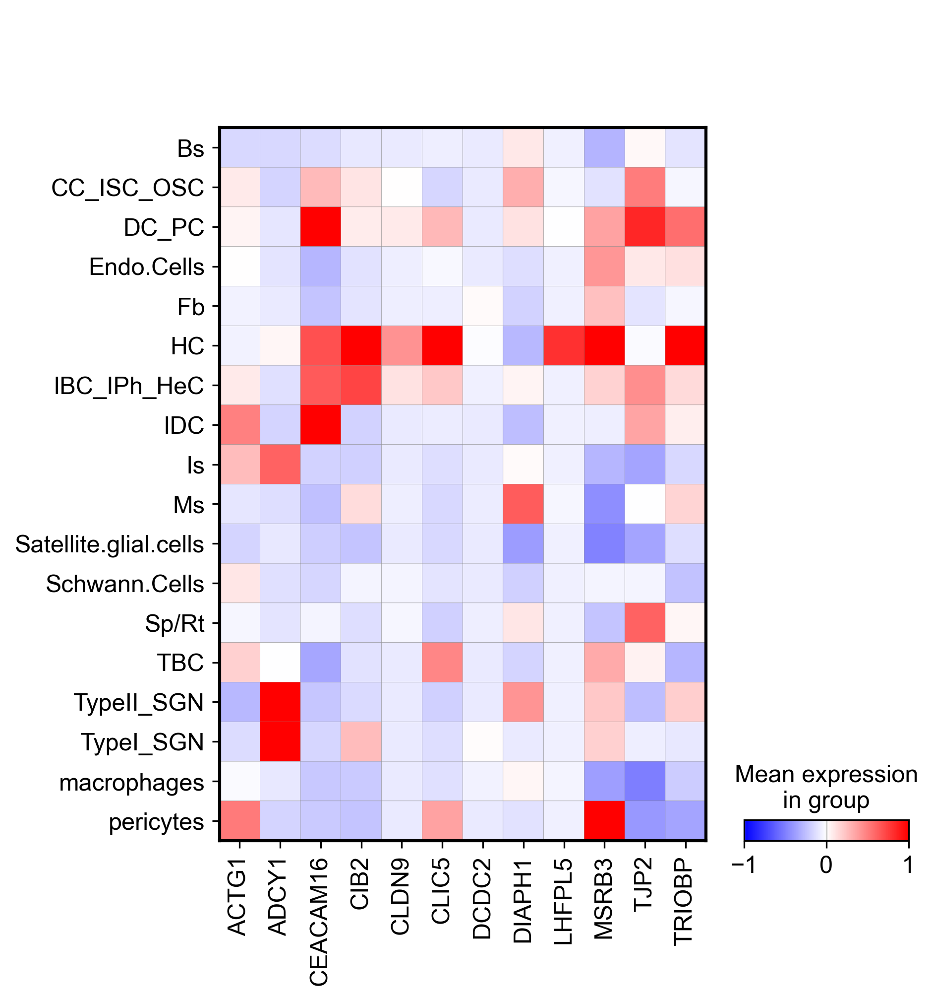

In [70]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_1y,groupby='cell_type')
gs = sc.pl.matrixplot(adata_1y, markers3_macaque, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="nonsyndromic_SGN_macaque_1year.pdf"
                     )

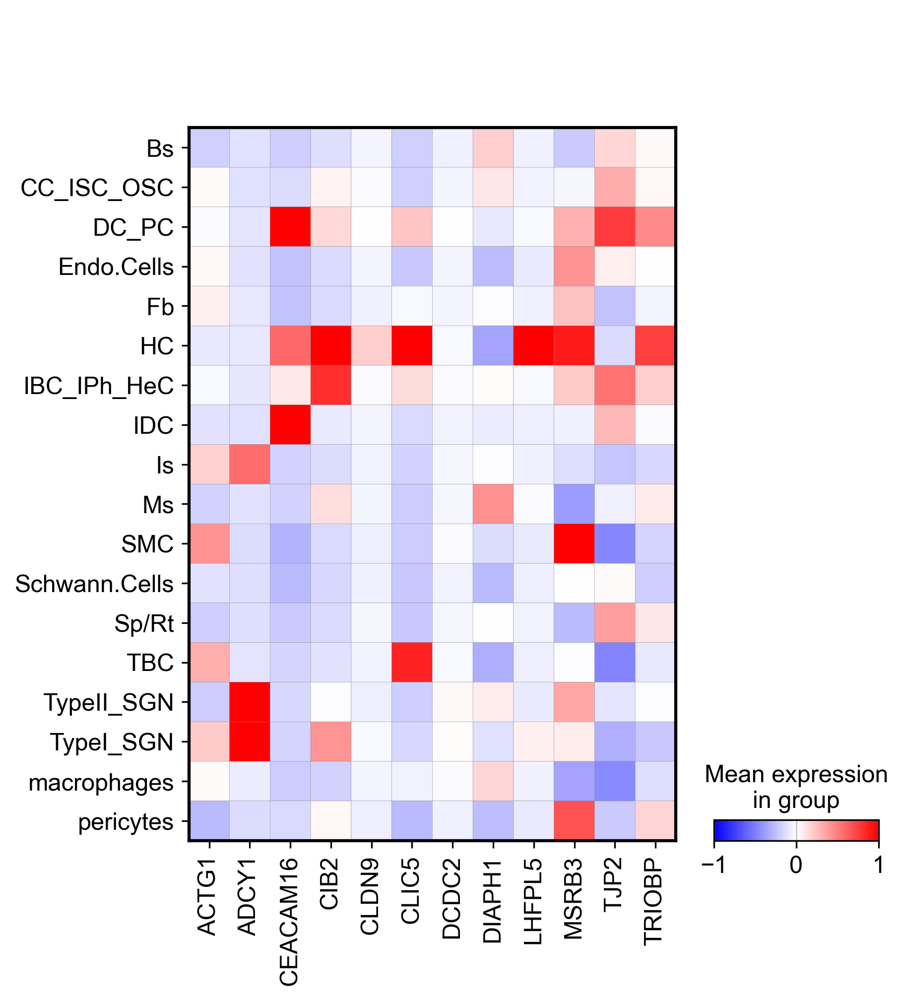

In [71]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_5y,groupby='cell_type')
gs = sc.pl.matrixplot(adata_5y, markers3_macaque, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="nonsyndromic_SGN_macaque_5year.pdf"
                     )

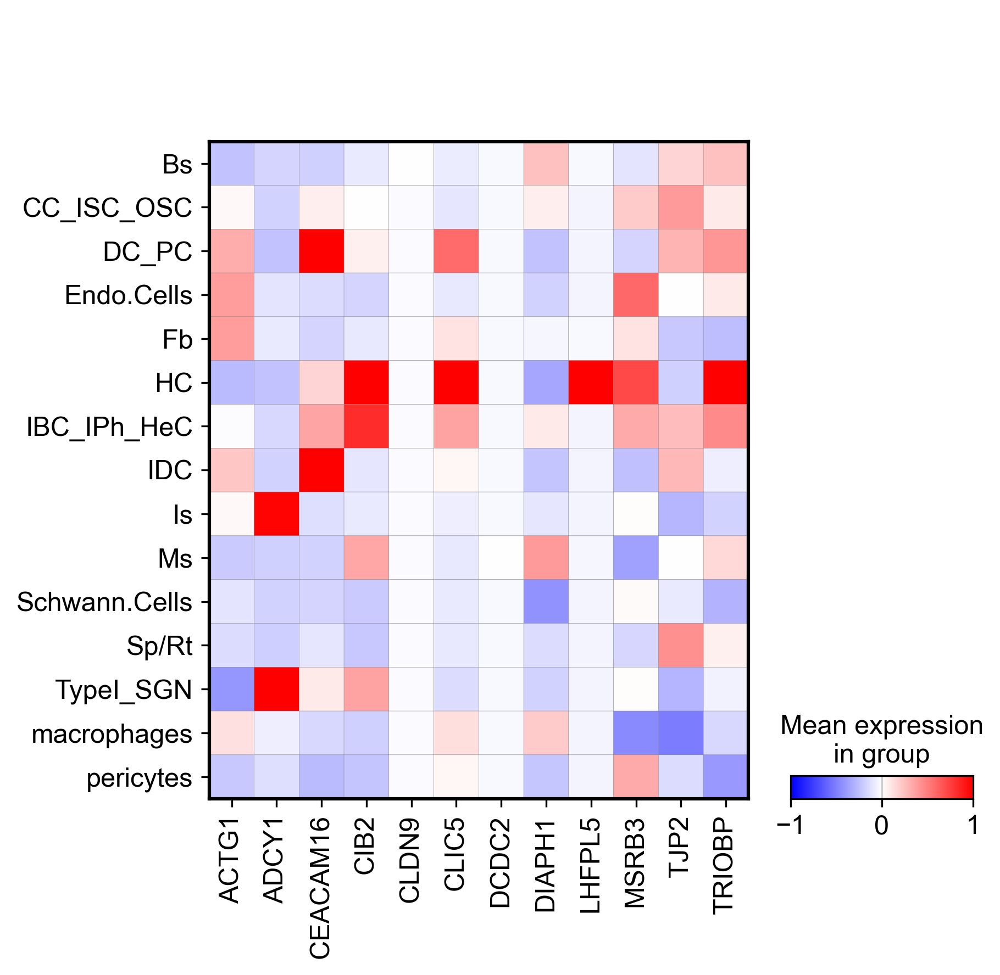

In [72]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_11y,groupby='cell_type')
gs = sc.pl.matrixplot(adata_11y, markers3_macaque, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="nonsyndromic_SGN_macaque_11year.pdf"
                     )

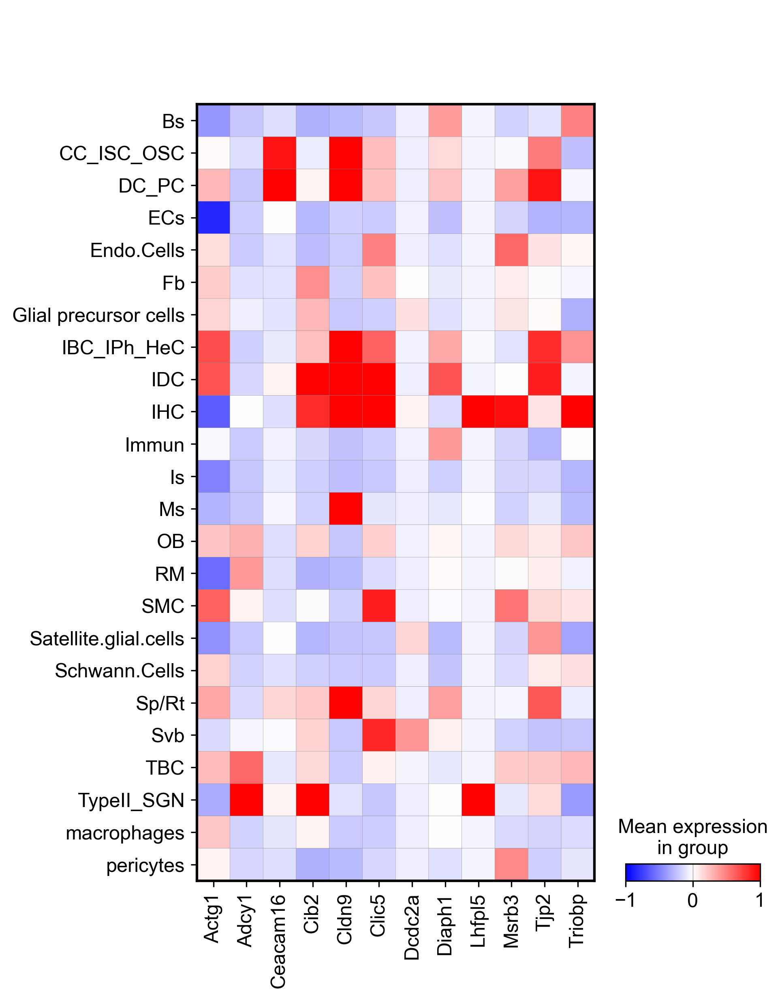

In [76]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P8,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P8, markers3_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="nonsyndromic_SGN_mouse_P8.pdf"
                     )

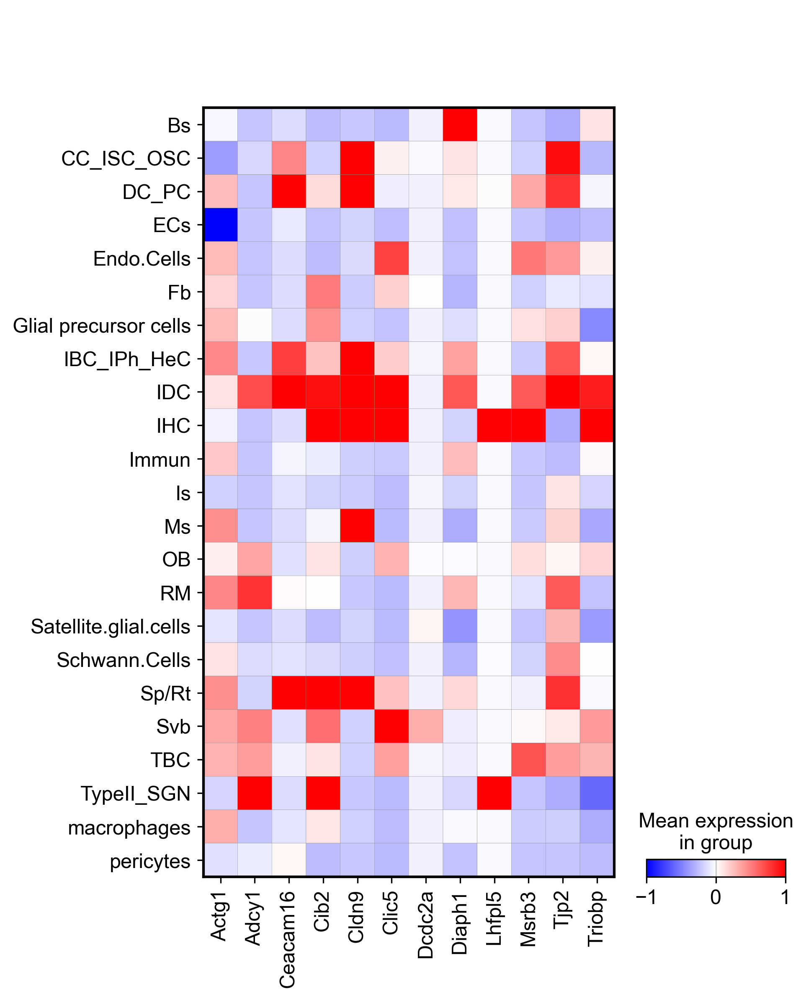

In [77]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P12,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P12, markers3_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="nonsyndromic_SGN_mouse_P12.pdf"
                     )

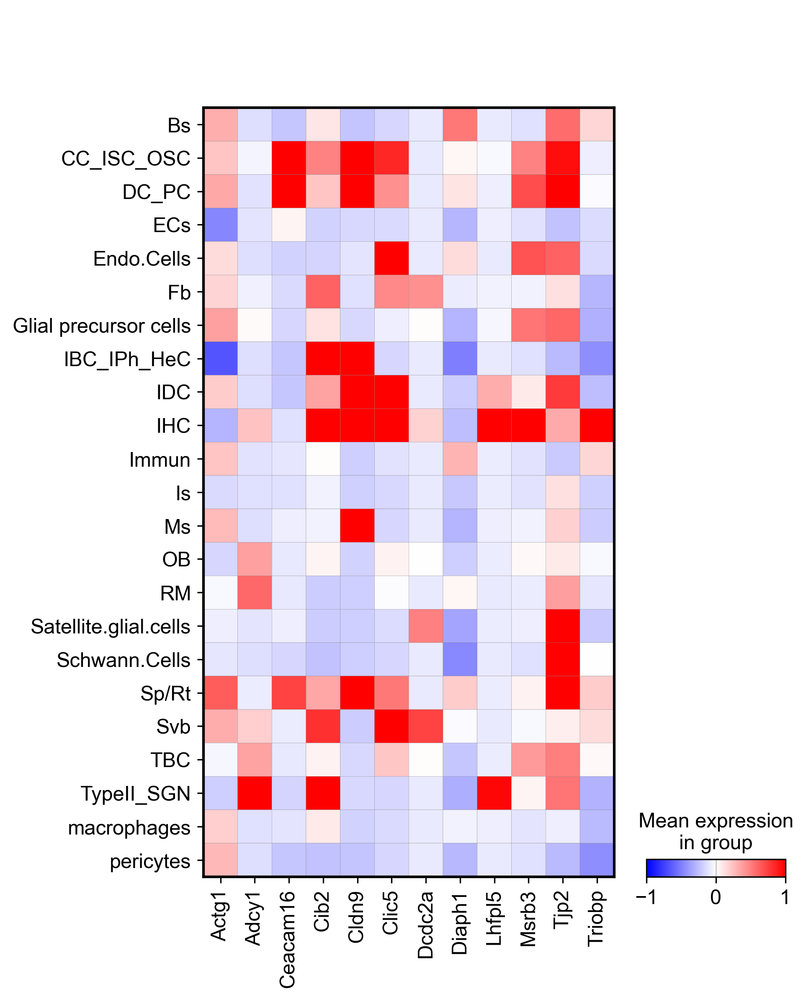

In [78]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P20,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P20, markers3_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="nonsyndromic_SGN_mouse_P20.pdf"
                     )

In [79]:
#genes related syndromic SNHL 
markers4_macaque = ['COL4A3','COL4A4','COL4A5','EYA1','SIX5','SIX1','SEMA3E','CHD7','KCNQ1','KCNE1','NDP','SLC26A4','KCNJ10',
            'HSD17B4','CLPP','LARS2','ERAL1','COL2A1','COL11A1','COL11A2','COL9A1','COL9A2','TCOF1',
            'POLR1D','POLR1C','MYO7A','USH1C','CDH23','PCDH15','USH2A','ADGRV1','CLRN1','HARS'

          ]#'FOXI1','HARS2','TWNK','WHRN',

In [80]:
#genes related syndromic SNHL 
markers4_mouse = ['Col4a3','Col4a4','Col4a5','Eya1','Six5','Six1','Sema3e','Chd7','Kcnq1','Kcne1','Ndp','Slc26a4','Kcnj10',
            'Hsd17b4','Clpp','Lars2','Eral1','Col2a1','Col11a1','Col11a2','Col9a1','Col9a2','Tcof1',
            'Polr1d','Polr1c','Myo7a','Ush1c','Cdh23','Pcdh15','Ush2a','Adgrv1','Clrn1','Hars'

          ]#'FOXI1','HARS2','TWNK','WHRN',

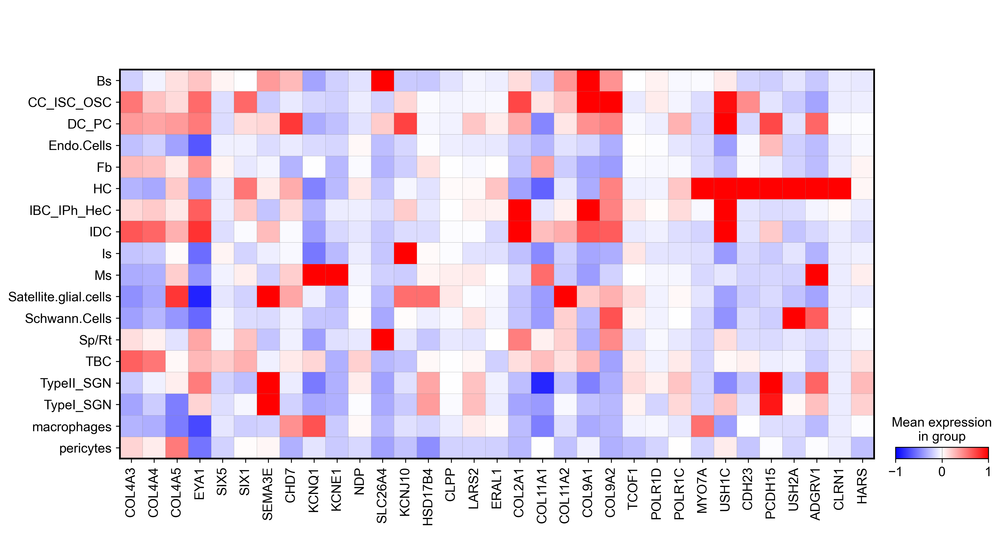

In [81]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_1y,groupby='cell_type')
gs = sc.pl.matrixplot(adata_1y, markers4_macaque, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="syndromic_macaque_1year.pdf"
                     )

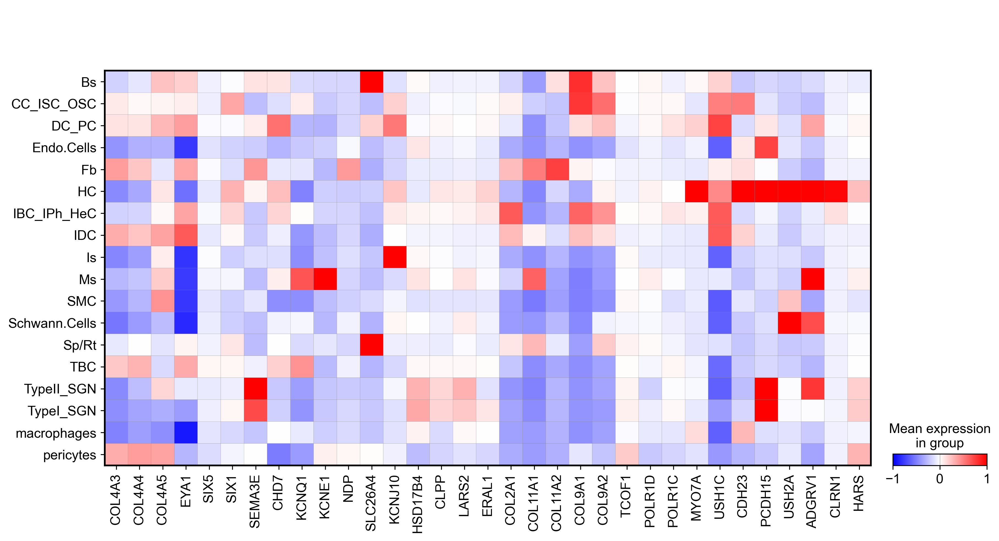

In [82]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_5y,groupby='cell_type')
gs = sc.pl.matrixplot(adata_5y, markers4_macaque, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="syndromic_macaque_5year.pdf"
                     )

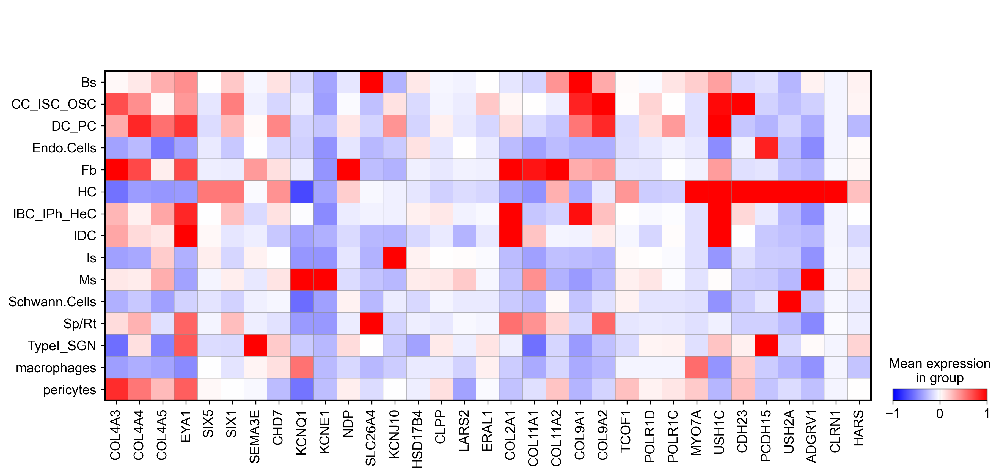

In [83]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_11y,groupby='cell_type')
gs = sc.pl.matrixplot(adata_11y, markers4_macaque, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="syndromic_macaque_11year.pdf"
                     )

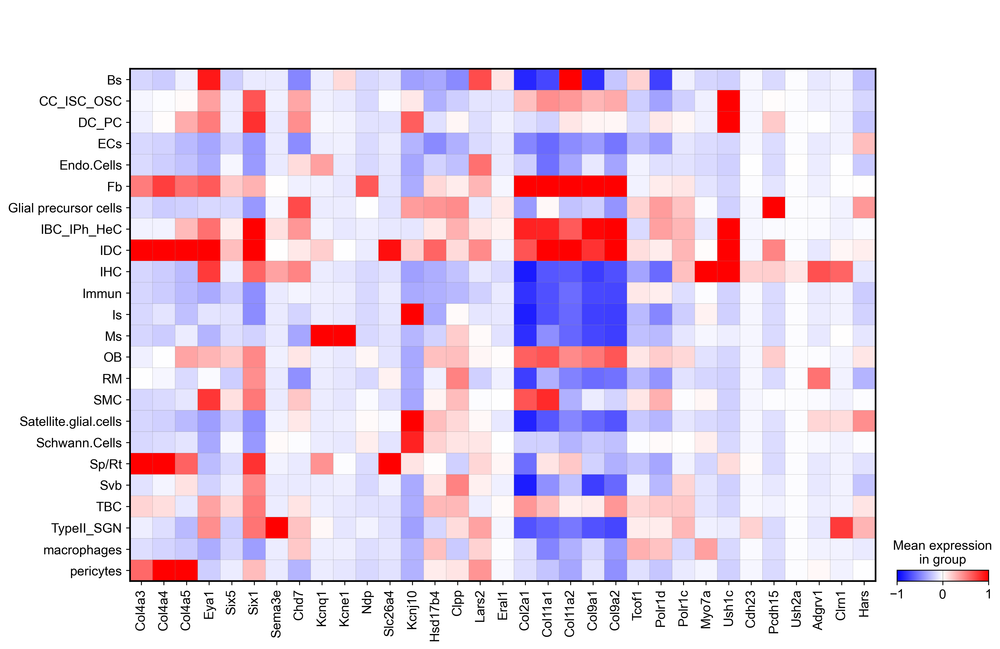

In [84]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P8,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P8, markers4_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="syndromic__mouse_P8.pdf"
                     )

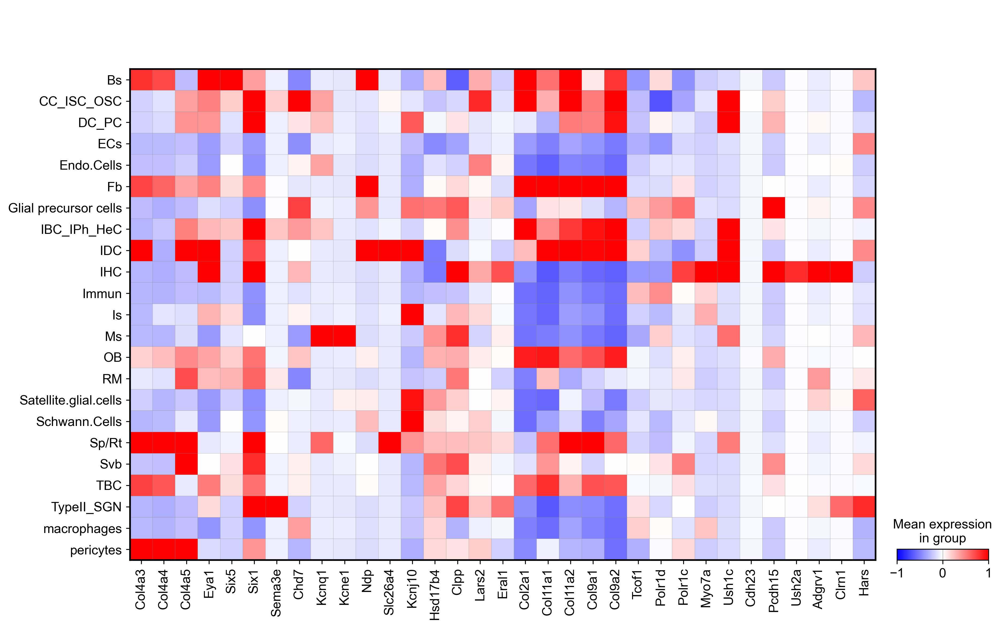

In [85]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P12,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P12, markers4_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="syndromic__mouse_P12.pdf"
                     )

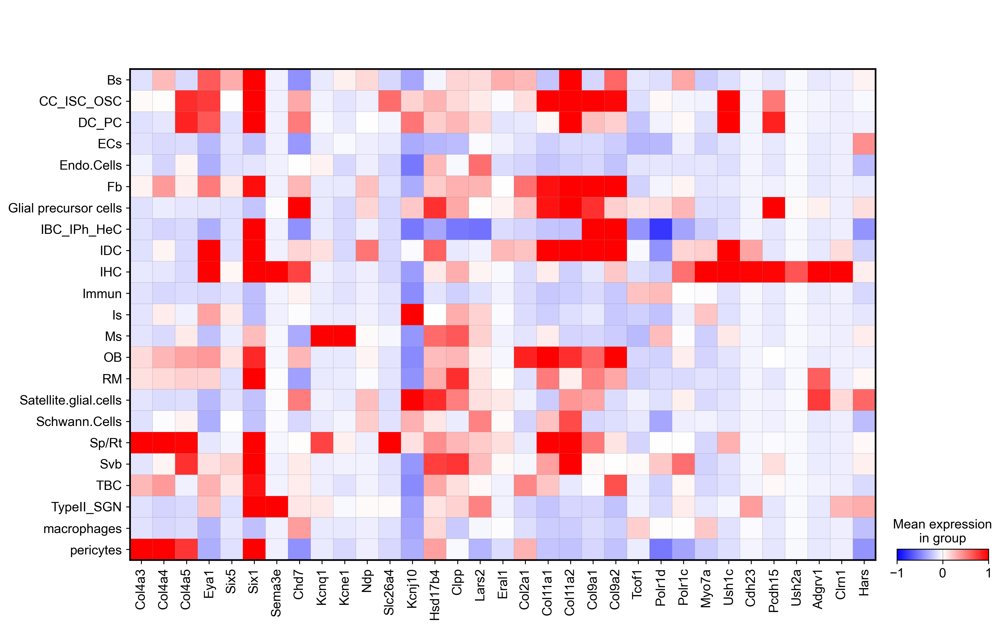

In [86]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P20,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P20, markers4_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="syndromic__mouse_P20.pdf"
                     )

In [87]:
#genes related autosomal nonsyndromic hearing loss
markers5 = ['DIAPH1', 'KCNQ4', 'IFNLR1', 'GJB2', 'GJB6', 'MYH14',"CEACAM16",'WFS1','LMX1A','TECTA','COCH','EYA4','MYO7A','COL11A2','POU4F3',
          'MYH9','ACTG1','MYO6','SIX1','SLC17A8','REST','GRHL2','NLRP3','TMC1','COL11A1','CRYM','P2RX2','CCDC50','TJP2','TNC','TBC1D24',
'CD164','OSBPL2','HOMER2','KITLG','MCM2','PTPRQ','DMXL2','MYO3A','PDE1C','TRRAP','PLS1','ATP2B2','SCD5','SLC12A2','MAP1B',

          ]

In [90]:
adata=adata_5y.concatenate(adata_11y)

C:\Users\Dell\AppData\Local\Temp\ipykernel_36076\729703846.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata=adata_5y.concatenate(adata_11y)


In [91]:
adata

AnnData object with n_obs × n_vars = 32250 × 14955
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region'
    var: 'gene_ids', 'feature_types', 'Gene', 'highly_variable-2', 'mt-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'means-2', 'dispersions-2', 'dispersions_norm-2', 'highly_variable-3', 'mt-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'means-3', 'dispersions-3', 'dispersions_norm-3', 'highly_variable-4', 'mt-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'means-4', 'dispersions-4', 'dispersions_norm-4',

In [92]:
sc.pp.filter_genes(adata,min_cells=1)
adata.layers["counts"] = adata.X.copy() 
adata.X = adata.layers["counts"].copy()
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
adata.layers["logcounts"] = adata.X.copy()
adata.layers["scaled"]=sc.pp.scale(adata.X,max_value=5,copy=True)
adata

AnnData object with n_obs × n_vars = 32250 × 14955
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_MT', 'pct_counts_MT', 'total_counts_HB', 'pct_counts_HB', 'total_counts_Hb', 'pct_counts_Hb', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'batch', 'age', 'cluster3', 'cell_type', 'n_counts', 'leiden_res2', 'leiden_res5', 'cluster4', 'region'
    var: 'gene_ids', 'feature_types', 'Gene', 'highly_variable-2', 'mt-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'means-2', 'dispersions-2', 'dispersions_norm-2', 'highly_variable-3', 'mt-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'means-3', 'dispersions-3', 'dispersions_norm-3', 'highly_variable-4', 'mt-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts-4', 'total_counts-4', 'means-4', 'dispersions-4', 'dispersions_norm-4',

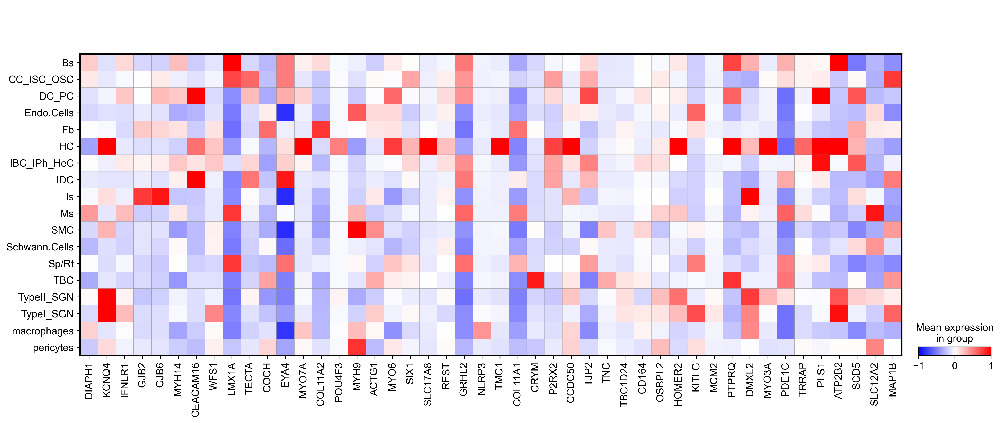

In [93]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata,groupby='cell_type')
gs = sc.pl.matrixplot(adata, markers5, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="autosomal_nonsyndromic_macaque.pdf"
                     )

In [94]:
adata_mouse=sc.read('mouse_p25_scvi.h5ad')

G:\Miniconda3\envs\scvi-env\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [95]:
adata_mouse.obs['cell_type'].value_counts()

Bs               1365
Ms                934
CC_ISC_OSC        455
TypeI_SGN         424
RM                353
TBC               339
Is                333
Fb                250
TypeII_SGN        250
pericytes         188
OB                182
DC                174
OHC               165
Schwann.Cells     125
PC                119
IBC_IPh_HeC       112
Sp/Rt             102
IDC                87
IHC                60
Name: cell_type, dtype: int64

In [96]:
cluster_annotation = {
    'Bs': 'Bs',
    'Ms': 'Ms',
    'CC_ISC_OSC': 'CC_ISC_OSC',
    'TypeI_SGN': 'TypeI_SGN',
     'RM': 'RM',
    'TBC': 'TBC',
    'Is': 'Is',
    'Fb': 'Fb',
     'TypeII_SGN': 'TypeII_SGN',
    'pericytes': 'pericytes',
    'OB': 'OB',
    'DC': 'DC_PC',
     'OHC': 'HC',
    'Schwann.Cells': 'Schwann.Cells',
    'PC': 'DC_PC',
    'IBC_IPh_HeC': 'IBC_IPh_HeC',
     'Sp/Rt': 'Sp/Rt',
    'IDC': 'IDC',
    'IHC': 'HC',
 
}
adata_mouse.obs['cell_type2'] = adata_mouse.obs['cell_type'].map(cluster_annotation).astype('category')

In [97]:
sc.pp.filter_genes(adata_mouse,min_cells=1)
adata_mouse.layers["counts"] = adata_mouse.X.copy() 
adata_mouse.X = adata_mouse.layers["counts"].copy()
sc.pp.normalize_total(adata_mouse)
sc.pp.log1p(adata_mouse)
adata_mouse.layers["logcounts"] = adata_mouse.X.copy()
adata_mouse.layers["scaled"]=sc.pp.scale(adata_mouse.X,max_value=5,copy=True)
adata_mouse

AnnData object with n_obs × n_vars = 6017 × 25558
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain', 'cluster', 'cluster2', 'cell_type2', 'cell_type3', 'cell_type', 'cluster5'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1', 'n_cells'
    uns: 'batch_colors', 'cluster2_colors', 'leiden', 'neighbors', 'umap', 'log1p'
    obsm: 'X_pca', 'X_scVI', 'X_umap'
    layers: 'counts', 'logcounts', 'scaled'
    obsp: 'connectivities', 'distances'

In [99]:
#genes related autosomal nonsyndromic hearing loss
markers5_mouse = ['Diaph1', 'Kcnq4', 'Ifnlr1', 'Gjb2', 'Gjb6', 'Myh14',"Ceacam16",'Wfs1','Lmx1a','Tecta','Coch','Eya4','Myo7a','Col11a2','Pou4f3',
          'Myh9','Actg1','Myo6','Six1','Slc17a8','Rest','Grhl2','Nlrp3','Tmc1','Col11a1','Crym','P2rx2','Ccdc50','Tjp2','Tnc','Tbc1d24',
'Cd164','Osbpl2','Homer2','Kitl','Mcm2','Ptprq','Dmxl2','Myo3a','Pde1c','Trrap','Pls1','Atp2b2','Slc12a2','Map1b',

          ]#'Scd5'

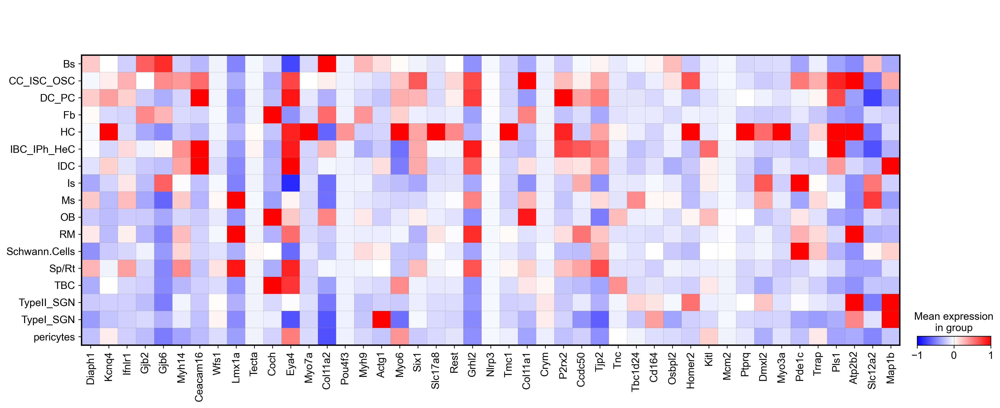

In [100]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse,groupby='cell_type2')
gs = sc.pl.matrixplot(adata_mouse, markers5_mouse, groupby='cell_type2',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="autosomal_nonsyndromic_mouse.pdf"
                     )

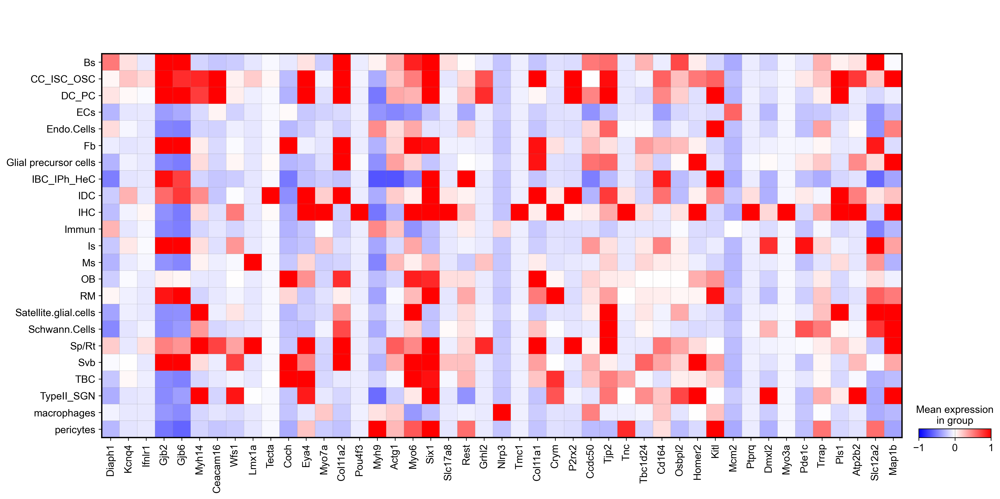

In [103]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P20,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P20, markers5_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="autosomal_nonsyndromic_mouse_P20.pdf"
                     )

In [106]:
#genes related autosomal recessive nonsyndromic hearing loss
markers6 = ['GJB2',
'MYO7A','MYO15A','SLC26A4','TMIE','TMC1','TMPRSS3','OTOF','CDH23',
'USH1C','OTOG','TECTA','OTOA',
'PCDH15','RDX','GRXCR1','GAB1','TRIOBP','CLDN14','MYO3A','ESRRB','MYO6','HGF','ADCY1','CIB2','MARVELD2','BDP1',
'COL11A2','PDZD7','SLC22A4','SLC26A5','DCDC2','LHFPL5',
'S1PR2','PNPT1','BSND','MSRB3','SYNE4','LOXHD1','TPRN','PTPRQ','OTOGL','TBC1D24','KARS','SERPINB6','CABP2',
           'NARS2','MET','TMEM132E','PPIP5K2','GRXCR2','EPS8',
'CLIC5','EPS8L2','ROR1','WBP2','ESRP1','MPZL2','CEACAM16','SPNS2','CLDN9','CLRN2','GAS2',
          ]#'ELMOD3','ESPN','FAM65B','GRAP','LDR1','PJVK','LRTOMT','STRC','TSPEAR','WHRN','GIPC3',

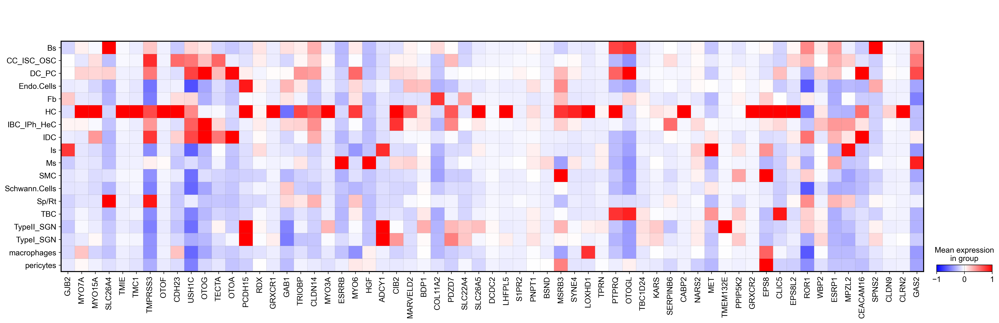

In [107]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata,groupby='cell_type')
gs = sc.pl.matrixplot(adata, markers6, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="autosomal_recessive_nonsyndromic_macaque.pdf"
                     )

In [109]:
#genes related autosomal recessive nonsyndromic hearing loss
markers6_mouse = ['Gjb2',
'Myo7a','Myo15','Slc26a4','Tmie','Tmc1','Tmprss3','Otof','Cdh23',
'Gipc3','Ush1c','Otog','Tecta','Otoa',
'Pcdh15','Rdx','Grxcr1','Gab1','Triobp','Cldn14','Myo3a','Esrrb','Myo6','Hgf','Adcy1','Cib2','Marveld2','Bdp1',
'Col11a2','Pdzd7','Slc22a4','Slc26a5','Dcdc2a','Lhfpl5',
'S1pr2','Pnpt1','Bsnd','Msrb3','Syne4','Loxhd1','Tprn','Ptprq','Otogl','Tbc1d24','Kars','Cabp2',
           'Nars2','Met','Tmem132e','Ppip5k2','Grxcr2','Eps8',
'Clic5','Eps8l2','Ror1','Wbp2','Esrp1','Mpzl2','Ceacam16','Spns2','Cldn9','Clrn2','Gas2',
           'Elmod3','Espn','Grap','Pjvk','Strc','Tspear','Whrn',
          ]#'ELMOD3','ESPN','FAM65B','GRAP','LDR1','PJVK','LRTOMT','STRC','TSPEAR','WHRN',

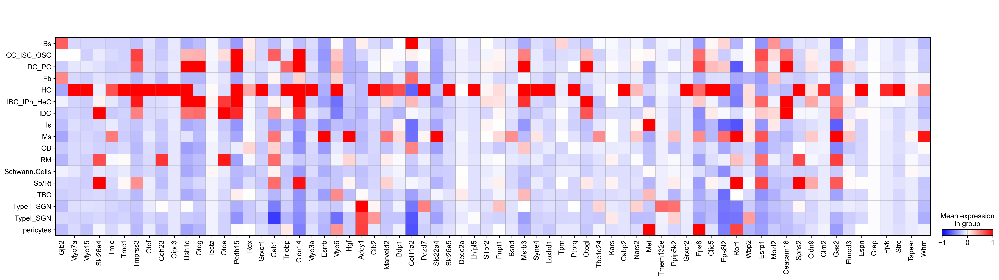

In [110]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse,groupby='cell_type2')
gs = sc.pl.matrixplot(adata_mouse, markers6, groupby='cell_type2',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="autosomal_recessive_nonsyndromic_mouse.pdf"
                     )

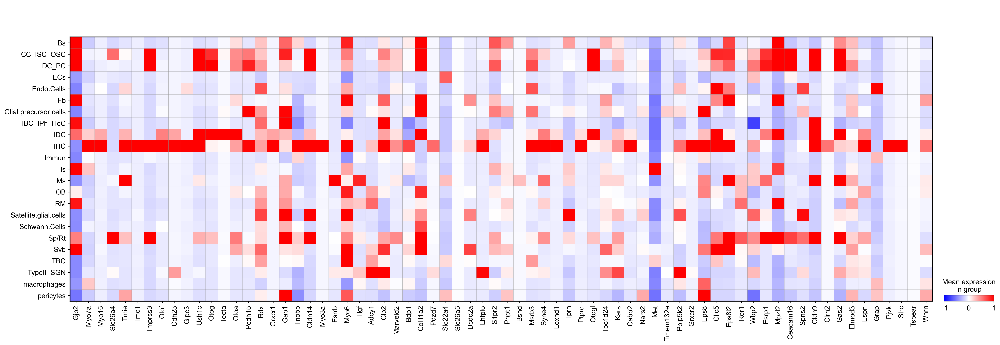

In [111]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P20,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P20, markers6_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="autosomal_recessive_nonsyndromic_mouse_P20.pdf"
                     )

In [112]:
#genes related x-linked nonsyndromic age_related cisplatin_related hearing loss
markers7 = ['PRPS1','POU3F4','SMPX','AIFM1','COL4A6','DIAPH3','ACVR1B','CCBE1','CNTNAP2','EIF4ENIF1','ISG20','NCALD',
'PRR14L','SFI1','SV2B','ZNF691','GRM8','IQGAP2','DCLK1','CDH13','PTPRD','CMIP',
'ESRRG','SIK3','PCDH20','SLC28A3','TRIOBP','ILDR1','EYA4','CEP104','SLC44A2','STRN','ARHGAP35',
'FAM167A','FAT2','LPP','NHSL1','OSBPL5','POU6F1','PDSS1','SCARA5','SH2D4B','VAV3',
          ]#'GRM7','METTL13','ST6GALNAC5',

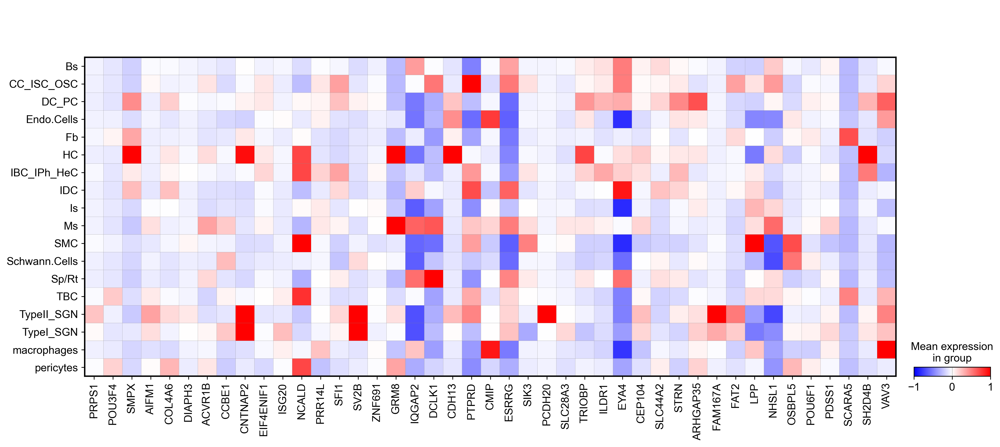

In [113]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata,groupby='cell_type')
gs = sc.pl.matrixplot(adata, markers7, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="x-link_age_cisplatin_macaque.pdf"
                     )

In [114]:
#genes related x-linked nonsyndromic age_related cisplatin_related hearing loss
markers7_mouse = ['Prps1','Pou3f4','Smpx','Aifm1','Col4a6','Diaph3','Acvr1b','Ccbe1','Cntnap2','Eif4enif1','Isg20','Ncald',
'Prr14l','Sfi1','Sv2b','Zfp691','Grm8','Iqgap2','Dclk1','Cdh13','Ptprd','Cmip',
'Esrrg','Sik3','Pcdh20','Slc28a3','Triobp','Ildr1','Eya4','Cep104','Slc44a2','Strn','Arhgap35',
'Fam167a','Fat2','Lpp','Nhsl1','Osbpl5','Pou6f1','Pdss1','Scara5','Sh2d4b','Vav3','Grm7','Eef1aknmt','St6galnac5'



    
          ]#,

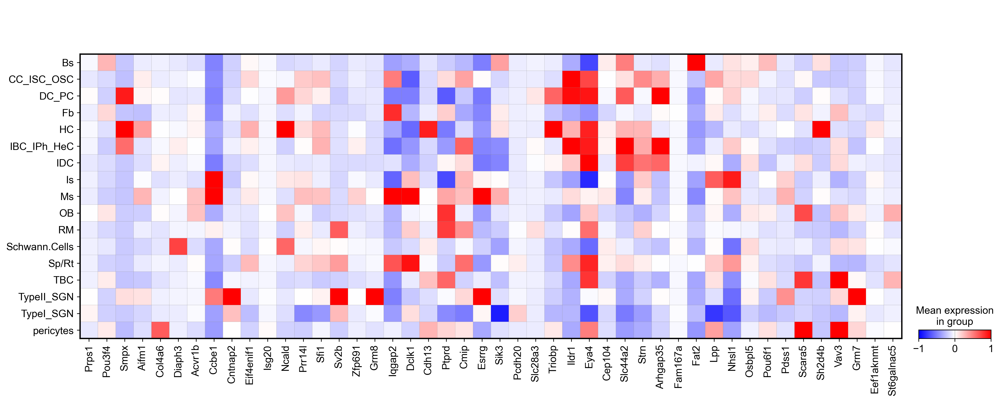

In [116]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse,groupby='cell_type2')
gs = sc.pl.matrixplot(adata_mouse, markers7_mouse, groupby='cell_type2',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="x-link_age_cisplatin_mouse.pdf"
                     )

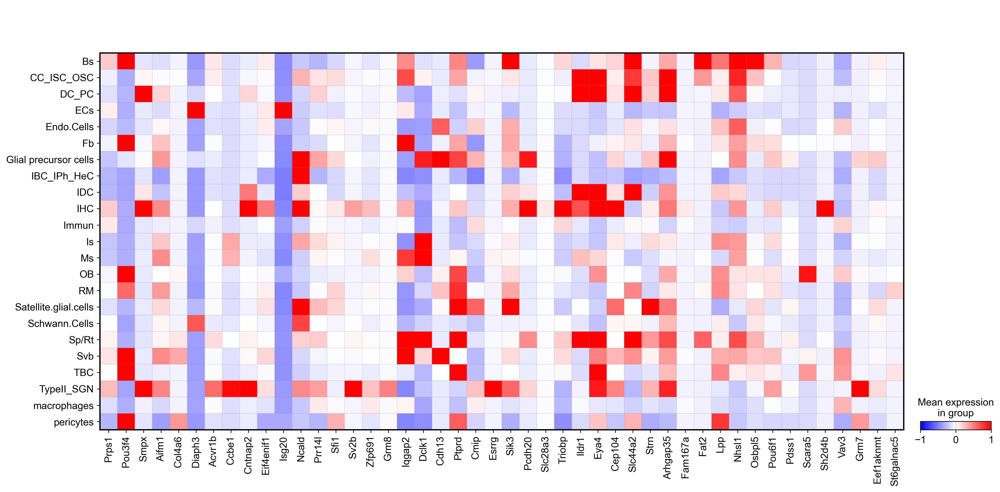

In [117]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P20,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P20, markers7_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="x-link_age_cisplatin_mouse_P20.pdf"
                     )

In [118]:
#genes related syndromic hearing loss
markers8 = [
'COL4A3','COL4A4','COL4A5','EYA1','SIX5','SIX1','SEMA3E','CHD7','KCNE1',
'NDP','SLC26A4','KCNJ10','HSD17B4','CLPP','LARS2','ERAL1','COL2A1','COL11A1','COL11A2',
'COL9A1','COL9A2','TCOF1','POLR1D','POLR1C','MYO7A','USH1C','CDH23','PCDH15','USH1G',
'USH2A','CLRN1','PAX3','MITF','SNAI2','SOX10','PAX3','EDN3','SOX10',

          ]#'EDNRB','TWNK','WHRN',

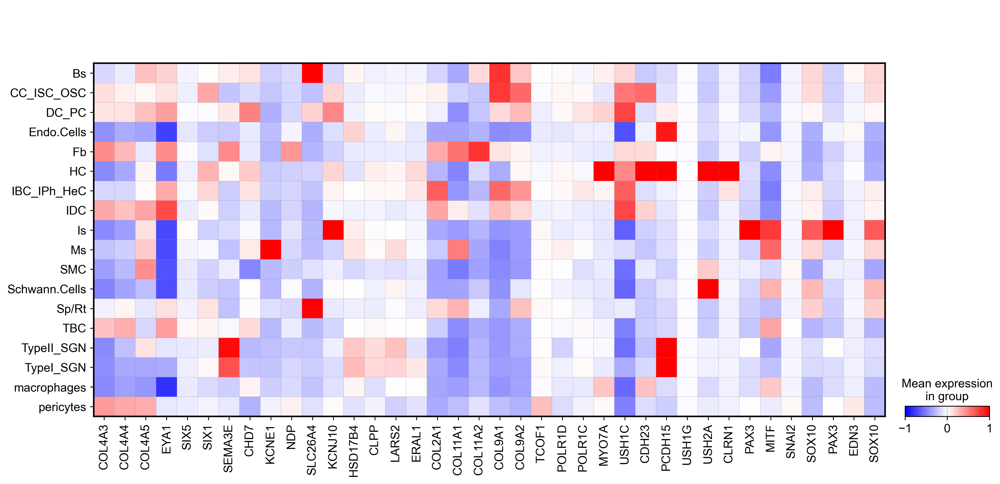

In [119]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata,groupby='cell_type')
gs = sc.pl.matrixplot(adata, markers8, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="syndrome_macaque.pdf"
                     )

In [120]:
#genes related syndromic hearing loss
markers8_mouse = [
'Col4a3','Col4a4','Eya1','Six5','Six1','Sema3e','Chd7','Kcne1',
'Ndp','Slc26a4','Kcnj10','Hsd17b4','Clpp','Lars2','Eral1','Col2a1','Col11a1','Col11a2',
'Col9a1','Col9a2','Tcof1','Polr1d','Polr1c','Myo7a','Ush1c','Cdh23','Pcdh15','Ush1g',
'Ush2a','Clrn1','Pax3','Mitf','Snai2','Sox10','Edn3','Sox10','Ednrb','Twnk','Whrn',

          ]#

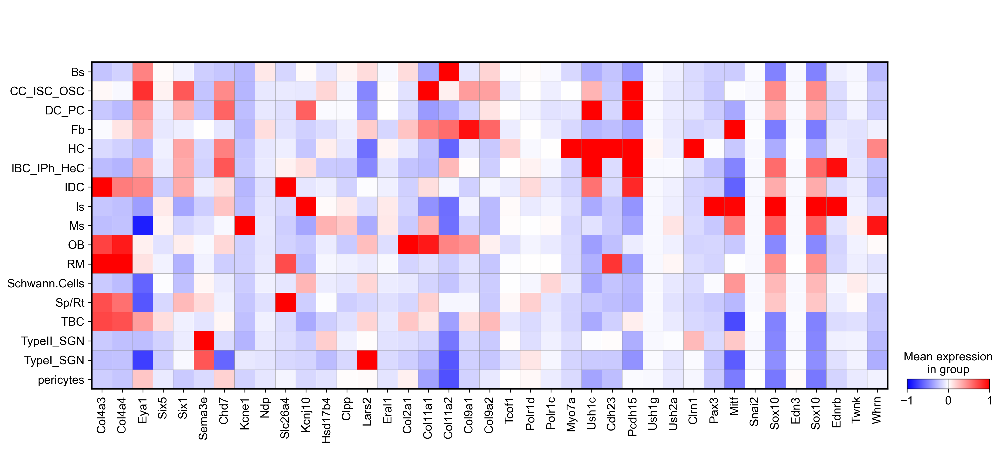

In [121]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse,groupby='cell_type2')
gs = sc.pl.matrixplot(adata_mouse, markers8_mouse, groupby='cell_type2',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,
   save="syndrome_mouse.pdf"
                     )

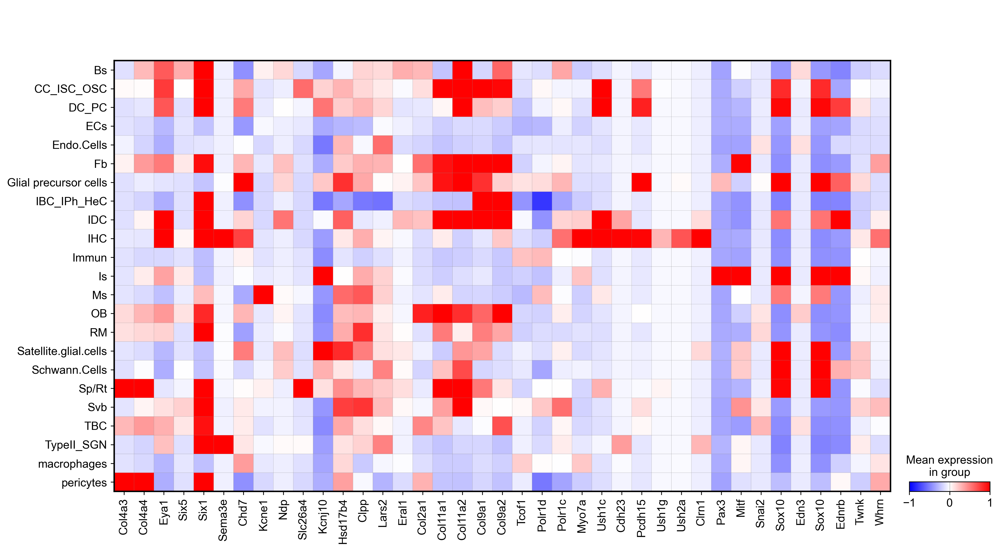

In [122]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata_mouse_pnas_P20,groupby='cell_type')
gs = sc.pl.matrixplot(adata_mouse_pnas_P20, markers8_mouse, groupby='cell_type',layer="scaled",#dendrogram=True,
                      vmin=-1,cmap="bwr",vmax=1,gene_symbols='gene_symbol',
   save="syndrome_mouse_P20.pdf"
                     )